# Project Viva New York
## Recommender Simulation for Mexican Restaurants

## Business Problem

The United States of America is well known for its large Mexican population along the states that compound the American border. However, this analysis takes place far away from the border reaching Canadian lands. As we move up north, native Spanish speakers (Mexican) population decreases and alongside with it, their cultural background. Mexico is well known for its famous and delicious cuisine. The gastronomy is the ensemble of culinary dishes and techniques from Mexico that takes part in traditions and Mexicans daily life, enriched by its country regions, which in turn are a mix of pre-Hispanic Mexico and European cuisine.
Being New York City one of the largest cities in the United States and in the world, known as a great land of opportunities, makes it a perfect place for a venue idea such as a Mexican restaurant. Even due to its large, populated boroughs such as Manhattan that could create a positive impact on sales, costs can be extremely high especially around downtown and its surrounding areas. Bringing to topic multiculturalism, ethnicity plays a vital role into selecting which type of venue will be a good fit and New York City is not an exception. 

New York City Boroughs:
1.	Manhattan
2.	Bronx
3.	Brooklyn
4.	Queens
5.	Staten Island


## Data Overview

The main purpose of this project is to analyze neighborhoods that compound all 5 boroughs from the city of New York and conclude through a series of analyses which areas will be considered, taking into account a series of analyses, the locations that will best fit the conditions for a Mexican restaurant.

The data used on this project is based alone on New York City. Through Foursquare, data such as venues, venues categories and coordinates will be used alongside neighborhoods latitudes and longitudes coordinates to create a merged dataset that will allow the audience to comprehend throughout geospatial data the geography of New York City, population density, and number of local venues in each neighborhood and borough. Machine learning clustering analyses allows to create data visualization of the city neighborhoods and venues dataset and to conclude which areas could be an excellent fit for a Mexican restaurant based on venues frequency and population.


In [180]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import json # library to handle JSON files
# !conda install -c conda-forge geopy --yes
from geopy.geocoders import Nominatim
import requests
from pandas.io.json import json_normalize
import matplotlib.cm as cm
import matplotlib.colors as colors
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
import folium 
import lxml

print('Libraries imported.')

Libraries imported.


In [181]:
with open('newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

In [182]:
neighborhoods_data = newyork_data['features']

In [183]:
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 
newyork_n = pd.DataFrame(columns=column_names)

In [184]:
for data in neighborhoods_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    newyork_n = newyork_n.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

In [185]:
newyork_n.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [186]:
newyork_n.groupby(['Borough']).count().drop(columns=['Latitude','Longitude']).reset_index()

,Borough,Neighborhood
0,Bronx,52
1,Brooklyn,70
2,Manhattan,40
3,Queens,81
4,Staten Island,63


In [187]:
print(newyork_n.shape[0])
print(len(newyork_n['Borough'].unique()))

306
5


In [188]:
geolocator = Nominatim(user_agent = 'foursquare_agent')
location = geolocator.geocode('New York City, New York')
latitude = location.latitude
longitude = location.longitude
print('Geographical Coordinates of New York City: {}, {}'.format(location.latitude, location.longitude))

Geographical Coordinates of New York City: 40.7127281, -74.0060152


In [189]:
borough_color = {'Bronx':'red', 'Manhattan':'blue', 'Brooklyn':'black', 'Queens':'yellow', 'Staten Island':'purple'}

In [190]:
ny_map = folium.Map(location =[latitude, longitude], zoom_start = 10)

for lat, lng, borough, neighborhood in zip (newyork_n['Latitude'],newyork_n['Longitude'],
                                            newyork_n['Borough'],newyork_n['Neighborhood']):
    label_text = borough + ' - ' + neighborhood
    label = folium.Popup(label_text)
    folium.CircleMarker(
        [lat,lng],
        radius=5,
        popup=label,
        color = borough_color[borough],
        fill_color=borough_color[borough],
        fill_opacity=0.7).add_to(ny_map)

ny_map

In [191]:
print(newyork_n['Borough'].unique())

['Bronx' 'Manhattan' 'Brooklyn' 'Queens' 'Staten Island']


In [192]:
CLIENT_ID = '3FBPDHHS253YALJVYVEBK4P4HYTTKIBNWC4ZEJDMN1F2NZJ4' 
CLIENT_SECRET = 'ROOGQGRZZQMZ1PB5K5BV4HBV2A2YUZRKVLF4RMBS13MPLGJL' 
VERSION = '20190530' 

In [193]:
LIMIT = 2000
radius = 10000
url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, radius, LIMIT)
url

'https://api.foursquare.com/v2/venues/explore?client_id=3FBPDHHS253YALJVYVEBK4P4HYTTKIBNWC4ZEJDMN1F2NZJ4&client_secret=ROOGQGRZZQMZ1PB5K5BV4HBV2A2YUZRKVLF4RMBS13MPLGJL&ll=40.7127281,-74.0060152&v=20190530&radius=10000&limit=2000'

In [194]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5fc9c71ce749390203ecf264'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'},
    {'name': '$-$$$$', 'key': 'price'}]},
  'headerLocation': 'New York',
  'headerFullLocation': 'New York',
  'headerLocationGranularity': 'city',
  'totalResults': 236,
  'suggestedBounds': {'ne': {'lat': 40.80272819000009,
    'lng': -73.8875016126839},
   'sw': {'lat': 40.62272800999991, 'lng': -74.12452878731608}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '5d5f24ec09484500079aee00',
       'name': 'Los Tacos No. 1',
       'location': {'address': '136 Church St',
        'lat': 40.714267,
        'lng': -74.008756,
        'labeledLatLngs': [{'label': 'display',
          'lat': 40

In [195]:
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [196]:
import json 
from pandas.io.json import json_normalize 

venues = results['response']['groups'][0]['items']  
newyork_nearby_venues = pd.json_normalize(venues) 


filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
newyork_nearby_venues = newyork_nearby_venues.loc[:, filtered_columns]


newyork_nearby_venues['venue.categories'] = newyork_nearby_venues.apply(get_category_type, axis=1)


newyork_nearby_venues.columns = [col.split(".")[-1] for col in newyork_nearby_venues.columns]

newyork_nearby_venues.head(10)

,name,categories,lat,lng
0,Los Tacos No. 1,Taco Place,40.714267,-74.008756
1,Aire Ancient Baths,Spa,40.718141,-74.004941
2,9/11 Memorial North Pool,Memorial Site,40.712077,-74.013187
3,One World Trade Center,Building,40.713069,-74.013133
4,Crown Shy,Restaurant,40.706187,-74.007490
5,sweetgreen,Salad Place,40.705626,-74.008282
6,The Rooftop @ Pier 17,Music Venue,40.705463,-74.001598
7,Battery Park City Esplanade,Park,40.711622,-74.017907
8,Pier 25 - Hudson River Park,Park,40.720193,-74.012950
9,Nelson A. Rockefeller Park,Park,40.717095,-74.016716


In [197]:
newyork_nearby_venues.shape

(100, 4)

In [198]:
print('{} venues were returned by Foursquare'.format(newyork_nearby_venues.shape[0]))

100 venues were returned by Foursquare


In [199]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
       
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)       

In [200]:
ny_venues = getNearbyVenues(names=newyork_n['Neighborhood'],
                                   latitudes=newyork_n['Latitude'],
                                   longitudes=newyork_n['Longitude']
                                  )

Wakefield
Co-op City
Eastchester
Fieldston
Riverdale
Kingsbridge
Marble Hill
Woodlawn
Norwood
Williamsbridge
Baychester
Pelham Parkway
City Island
Bedford Park
University Heights
Morris Heights
Fordham
East Tremont
West Farms
High  Bridge
Melrose
Mott Haven
Port Morris
Longwood
Hunts Point
Morrisania
Soundview
Clason Point
Throgs Neck
Country Club
Parkchester
Westchester Square
Van Nest
Morris Park
Belmont
Spuyten Duyvil
North Riverdale
Pelham Bay
Schuylerville
Edgewater Park
Castle Hill
Olinville
Pelham Gardens
Concourse
Unionport
Edenwald
Bay Ridge
Bensonhurst
Sunset Park
Greenpoint
Gravesend
Brighton Beach
Sheepshead Bay
Manhattan Terrace
Flatbush
Crown Heights
East Flatbush
Kensington
Windsor Terrace
Prospect Heights
Brownsville
Williamsburg
Bushwick
Bedford Stuyvesant
Brooklyn Heights
Cobble Hill
Carroll Gardens
Red Hook
Gowanus
Fort Greene
Park Slope
Cypress Hills
East New York
Starrett City
Canarsie
Flatlands
Mill Island
Manhattan Beach
Coney Island
Bath Beach
Borough Park
Dyker

In [22]:
ny_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield,40.894705,-73.847201,Lollipops Gelato,40.894123,-73.845892,Dessert Shop
1,Wakefield,40.894705,-73.847201,Rite Aid,40.896649,-73.844846,Pharmacy
2,Wakefield,40.894705,-73.847201,Walgreens,40.896528,-73.844700,Pharmacy
3,Wakefield,40.894705,-73.847201,Carvel Ice Cream,40.890487,-73.848568,Ice Cream Shop
4,Wakefield,40.894705,-73.847201,Dunkin',40.890459,-73.849089,Donut Shop


In [23]:
print('There are {} neighborhoods.'.format(len(ny_venues['Neighborhood'].unique())))
print('There are {} uniques categories.'.format(len(ny_venues['Venue Category'].unique())))

There are 302 neighborhoods.
There are 428 uniques categories.


In [24]:
ny_onehot = pd.get_dummies(ny_venues[['Venue Category']], prefix="", prefix_sep="")


ny_onehot['Neighborhood'] = ny_venues['Neighborhood'] 


fixed_columns = [ny_onehot.columns[-1]] + list(ny_onehot.columns[:-1])
ny_onehot = ny_onehot[fixed_columns]

ny_onehot.head()

,Yoga Studio,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,Auto Garage,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bath House,Beach,Beach Bar,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burmese Restaurant,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Campground,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Check Cashing Service,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Basketball Court,College Bookstore,College Cafeteria,College Stadium,College Theater,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dosa Place,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Exhibit,Eye Doctor,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Go Kart Track,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,Herbs & Spices Store,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Hotpot Restaurant,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Leather Goods Store,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Locksmith,Lounge,Malay Restaurant,Market,Martial Arts School,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,Neighborhood,New American Restaurant,Newsstand,Nightclub,Nightlife Spot,Non-Profit,Noodle House,North Indian Restaurant,Office,Opera House,Optical Sho

In [130]:
# ny_venues_grouped = ny_onehot.groupby('Neighborhood').mean().reset_index()
ny_venues_grouped.head()

,Neighborhood,Yoga Studio,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,Auto Garage,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bath House,Beach,Beach Bar,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burmese Restaurant,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Campground,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Check Cashing Service,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Basketball Court,College Bookstore,College Cafeteria,College Stadium,College Theater,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dosa Place,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Exhibit,Eye Doctor,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Go Kart Track,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,Herbs & Spices Store,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Hotpot Restaurant,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Leather Goods Store,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Locksmith,Lounge,Malay Restaurant,Market,Martial Arts School,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Nightlife Spot,Non-Profit,Noodle House,North Indian Restaurant,Office,Opera House,Optical Sho

In [45]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [46]:
num_top_venues = 5

indicators = ['st', 'nd', 'rd']


columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))


ny_venues_sorted = pd.DataFrame(columns=columns)
ny_venues_sorted['Neighborhood'] = ny_venues_grouped['Neighborhood']

for ind in np.arange(ny_venues_grouped.shape[0]):
    ny_venues_sorted.iloc[ind, 1:] = return_most_common_venues(ny_venues_grouped.iloc[ind, :], num_top_venues)

ny_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Allerton,Pizza Place,Deli / Bodega,Spa,Supermarket,Chinese Restaurant
1,Annadale,American Restaurant,Pizza Place,Dance Studio,Train Station,Deli / Bodega
2,Arden Heights,Deli / Bodega,Pharmacy,Coffee Shop,Bus Stop,Pizza Place
3,Arlington,Grocery Store,Deli / Bodega,Coffee Shop,Bus Stop,Home Service
4,Arrochar,Bus Stop,Italian Restaurant,Deli / Bodega,Pizza Place,Pharmacy


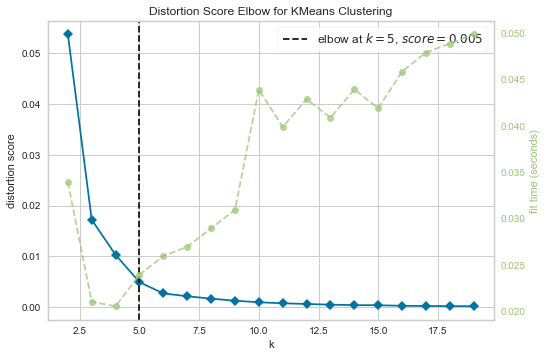

In [105]:
ny_grouped_cluster = ny_venues_grouped_mexican.drop('Neighborhood',1)
X = ny_grouped_cluster
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,20))

visualizer.fit(X)
visualizer.show()

In [48]:
kclusters = 5
kmeans = KMeans(n_clusters = kclusters, random_state=4).fit(ny_grouped_cluster)
kmeans.labels_[:21]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 1, 3, 0, 4, 0, 0, 0, 1])

In [126]:
ny_venues_grouped_mexican['Cluster Labels'] = ny_grouped_cluster['Cluster Labels']
ny_venues_grouped_mexican.head()

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Neighborhood,Mexican Restaurant,Cluster Labels
0,Allerton,0.0,0
1,Annadale,0.0,0
2,Arden Heights,0.0,0
3,Arlington,0.0,0
4,Arrochar,0.0,0


In [134]:
ny_mergedmx = ny_venues_grouped_mexican
ny_mergedmx = ny_mergedmx.join(ny_venues.set_index('Neighborhood'), on='Neighborhood')
ny_mergedmx.head()

,Neighborhood,Mexican Restaurant,Cluster Labels,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Allerton,0.0,0,40.865788,-73.859319,Domenick's Pizzeria,40.865576,-73.858124,Pizza Place
0,Allerton,0.0,0,40.865788,-73.859319,White Castle,40.866065,-73.862307,Fast Food Restaurant
0,Allerton,0.0,0,40.865788,-73.859319,Sal & Doms Bakery,40.865377,-73.855236,Dessert Shop
0,Allerton,0.0,0,40.865788,-73.859319,Bronx Martial Arts Academy,40.865721,-73.857529,Martial Arts School
0,Allerton,0.0,0,40.865788,-73.859319,Dunkin',40.865156,-73.858950,Donut Shop


In [142]:
ny_mergedmx = ny_mergedmx.join(newyork_n.set_index('Neighborhood'), on='Neighborhood')
ny_mergedmx = ny_mergedmx.set_index('Borough')
ny_mergedmx.reset_index(inplace=True)
ny_mergedmx.drop(columns=['Latitude', 'Longitude'], inplace=True)
ny_mergedmx.head()

,Borough,Neighborhood,Mexican Restaurant,Cluster Labels,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bronx,Allerton,0.0,0,40.865788,-73.859319,Domenick's Pizzeria,40.865576,-73.858124,Pizza Place
1,Bronx,Allerton,0.0,0,40.865788,-73.859319,White Castle,40.866065,-73.862307,Fast Food Restaurant
2,Bronx,Allerton,0.0,0,40.865788,-73.859319,Sal & Doms Bakery,40.865377,-73.855236,Dessert Shop
3,Bronx,Allerton,0.0,0,40.865788,-73.859319,Bronx Martial Arts Academy,40.865721,-73.857529,Martial Arts School
4,Bronx,Allerton,0.0,0,40.865788,-73.859319,Dunkin',40.865156,-73.858950,Donut Shop


In [49]:
ny_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

ny_merged = newyork_n
ny_merged = ny_merged.join(ny_venues_sorted.set_index('Neighborhood'), on='Neighborhood')
ny_merged.head()

,Borough,Neighborhood,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Bronx,Wakefield,40.894705,-73.847201,0,Pharmacy,Sandwich Place,Donut Shop,Deli / Bodega,Gas Station
1,Bronx,Co-op City,40.874294,-73.829939,0,Bus Station,Bar,Restaurant,Baseball Field,Chinese Restaurant
2,Bronx,Eastchester,40.887556,-73.827806,0,Bus Station,Caribbean Restaurant,Deli / Bodega,Diner,Bowling Alley
3,Bronx,Fieldston,40.895437,-73.905643,0,Medical Supply Store,River,Plaza,Fish & Chips Shop,Event Space
4,Bronx,Riverdale,40.890834,-73.912585,0,Park,Playground,Home Service,Bank,Plaza


In [141]:
import matplotlib.cm as cm
import matplotlib.colors as colors
ny_clusters = folium.Map(location = [latitude, longitude], zoom_start=10)


x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


markers_colors = []
for lat, lon, poi, cluster, borough in zip(ny_mergedmx['Neighborhood Latitude'], ny_mergedmx['Neighborhood Longitude'], ny_mergedmx['Neighborhood'], ny_mergedmx['Cluster Labels'], ny_mergedmx['Borough']):
    label = folium.Popup(str(borough) + " " + str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(ny_clusters)
    
ny_clusters

In [203]:
ny_mergedmx.loc[ny_mergedmx['Cluster Labels'] == 0].head()
# ny_mergedmx.columns[[1] + list(range(5, ny_merged.shape[1]))]]

,Borough,Neighborhood,Mexican Restaurant,Cluster Labels,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bronx,Allerton,0.0,0,40.865788,-73.859319,Domenick's Pizzeria,40.865576,-73.858124,Pizza Place
1,Bronx,Allerton,0.0,0,40.865788,-73.859319,White Castle,40.866065,-73.862307,Fast Food Restaurant
2,Bronx,Allerton,0.0,0,40.865788,-73.859319,Sal & Doms Bakery,40.865377,-73.855236,Dessert Shop
3,Bronx,Allerton,0.0,0,40.865788,-73.859319,Bronx Martial Arts Academy,40.865721,-73.857529,Martial Arts School
4,Bronx,Allerton,0.0,0,40.865788,-73.859319,Dunkin',40.865156,-73.858950,Donut Shop


In [204]:
ny_mergedmx.loc[ny_mergedmx['Cluster Labels'] == 1].head()
# ny_merged.columns[[1] + list(range(5, ny_merged.shape[1]))]]

,Borough,Neighborhood,Mexican Restaurant,Cluster Labels,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
513,Bronx,Baychester,0.05,1,40.866858,-73.835798,Caridad & Louie,40.865843,-73.837707,Spanish Restaurant
514,Bronx,Baychester,0.05,1,40.866858,-73.835798,Planet Fitness,40.863298,-73.835568,Gym / Fitness Center
515,Bronx,Baychester,0.05,1,40.866858,-73.835798,Dunkin',40.867800,-73.833365,Donut Shop
516,Bronx,Baychester,0.05,1,40.866858,-73.835798,Chase Bank,40.866076,-73.838370,Bank
517,Bronx,Baychester,0.05,1,40.866858,-73.835798,Pizza Hut,40.868622,-73.833808,Pizza Place


In [205]:
ny_mergedmx.loc[ny_mergedmx['Cluster Labels'] == 2].head()
# ny_merged.columns[[1] + list(range(5, ny_merged.shape[1]))]]

,Borough,Neighborhood,Mexican Restaurant,Cluster Labels,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
2141,Staten Island,Clifton,0.105263,2,40.619178,-74.072642,Bayou,40.616853,-74.068161,Cajun / Creole Restaurant
2142,Staten Island,Clifton,0.105263,2,40.619178,-74.072642,Korzo Klub,40.618819,-74.069430,Eastern European Restaurant
2143,Staten Island,Clifton,0.105263,2,40.619178,-74.072642,Maizal,40.618335,-74.069547,Mexican Restaurant
2144,Staten Island,Clifton,0.105263,2,40.619178,-74.072642,Pronto Pizza,40.616449,-74.067943,Pizza Place
2145,Staten Island,Clifton,0.105263,2,40.619178,-74.072642,Top Tomato Super Store,40.617313,-74.068093,Grocery Store


In [206]:
ny_mergedmx.loc[ny_mergedmx['Cluster Labels'] == 3].head()
# ny_merged.columns[[1] + list(range(5, ny_merged.shape[1]))]]

,Borough,Neighborhood,Mexican Restaurant,Cluster Labels,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
272,Manhattan,Battery Park City,0.015152,3,40.711932,-74.016869,Battery Park City Esplanade,40.711622,-74.017907,Park
273,Manhattan,Battery Park City,0.015152,3,40.711932,-74.016869,Hudson Eats,40.712666,-74.015901,Food Court
274,Manhattan,Battery Park City,0.015152,3,40.711932,-74.016869,Institute of Culinary Education,40.712399,-74.015971,Cooking School
275,Manhattan,Battery Park City,0.015152,3,40.711932,-74.016869,"Waterfront Plaza, Brookfield Place",40.713241,-74.016241,Plaza
276,Manhattan,Battery Park City,0.015152,3,40.711932,-74.016869,Equinox Brookfield Place,40.712704,-74.014995,Gym


In [207]:
ny_mergedmx.loc[ny_mergedmx['Cluster Labels'] == 4].head()
# ny_merged.columns[[1] + list(range(5, ny_merged.shape[1]))]]

,Borough,Neighborhood,Mexican Restaurant,Cluster Labels,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
605,Bronx,Bedford Park,0.083333,4,40.870185,-73.885512,E. Mosholu Parkway South and Bainbridge Ave,40.872248,-73.882286,Park
606,Bronx,Bedford Park,0.083333,4,40.870185,-73.885512,My Place Family Pizza,40.869262,-73.889476,Pizza Place
607,Bronx,Bedford Park,0.083333,4,40.870185,-73.885512,National Restaurant & Coffee,40.873007,-73.889082,Diner
608,Bronx,Bedford Park,0.083333,4,40.870185,-73.885512,Webster Cafe,40.867290,-73.883619,Diner
609,Bronx,Bedford Park,0.083333,4,40.870185,-73.885512,Jolly Tinker,40.867451,-73.883536,Italian Restaurant


In [56]:
n = 5
ny_mostcommon = ny_merged['1st Most Common Venue'].value_counts()[:n].sort_values(ascending=False)
ny_mostcommon.head()

Pizza Place           30
Italian Restaurant    30
Deli / Bodega         26
Coffee Shop           13
Park                  13
Name: 1st Most Common Venue, dtype: int64

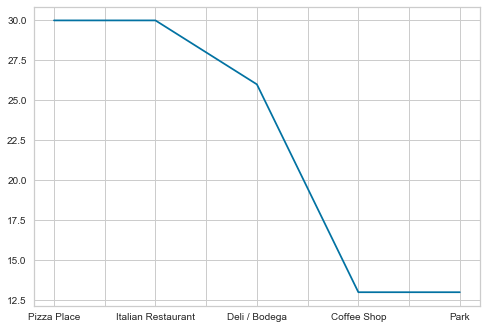

In [57]:
ny_mostcommon.plot()

In [162]:
# nn_cluster = pd.DataFrame(ny_merged.groupby('Cluster Labels').count()['Neighborhood']).reset_index('Cluster Labels')
nn_cluster['Neighborhood Ratio'] = nn_cluster['Neighborhood'] / nn_cluster['Neighborhood'].sum()
nn_cluster['Neighborhood Ratio'] = pd.Series(["{0:.2f}%".format(val*100) for val in nn_cluster['Neighborhood Ratio']])
# nn_cluster['Venues'] = ny_merged.groupby('Cluster Labels').count()

nn_cluster

,Cluster Labels,Neighborhood,Neighborhood Ratio
0,0,220,71.90%
1,1,30,9.80%
2,2,8,2.61%
3,3,36,11.76%
4,4,12,3.92%


In [163]:
print(nn_cluster['Neighborhood'].sum())

306


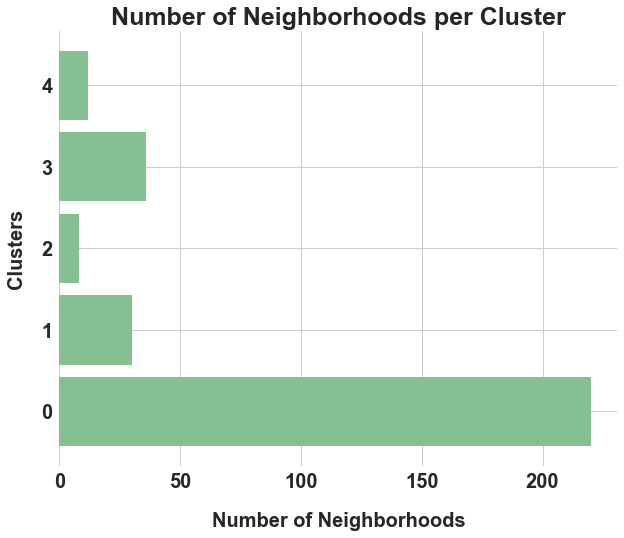

In [297]:
import matplotlib.pyplot as plt
neighborhoods = nn_cluster['Neighborhood']
clusters = nn_cluster['Cluster Labels']

fig, ax = plt.subplots(figsize=(10,8))
width = 0.85
ind = np.arange(len(neighborhoods))

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)


ax.barh(ind, neighborhoods, width, color='#86bf91')
ax.set_yticks(ind)
ax.set_yticklabels(clusters)
plt.title('Number of Neighborhoods per Cluster', fontsize = 25, weight = 'bold')
plt.xticks(fontsize=20,weight = 'bold')
plt.yticks(fontsize=20,weight = 'bold')
plt.xlabel('Number of Neighborhoods', fontsize = 20, labelpad=20,weight = 'bold')
plt.ylabel('Clusters', fontsize = 20, labelpad = 15,weight = 'bold')
plt.show()

#### As above graph shows, Clusters 0 compound almost 72% of 306 neighborhoods. 

In [68]:
nyvenuescount = ny_venues.groupby('Neighborhood').count()
nyvenuescount.head()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Allerton,30,30,30,30,30,30
Annadale,11,11,11,11,11,11
Arden Heights,5,5,5,5,5,5
Arlington,6,6,6,6,6,6
Arrochar,21,21,21,21,21,21


In [288]:
# nyvenuescount = pd.DataFrame(ny_mergedmx.groupby('Cluster Labels').count()['Neighborhood']).reset_index('Cluster Labels')
nyvenuescount['Venues %'] = nyvenuescount['Venues'] / nyvenuescount['Venues'].sum()
nyvenuescount['Venues %'] = pd.Series(["{0:.2f}%".format(val*100) for val in nyvenuescount['Venues %']])
nyvenuescount.rename(columns={'Neighborhood':'Venues'}, inplace=True)
nyvenuescount

,Cluster Labels,Venues,Venues %
0,0,6242,59.90%
1,1,1240,11.90%
2,2,184,1.77%
3,3,2292,21.99%
4,4,463,4.44%


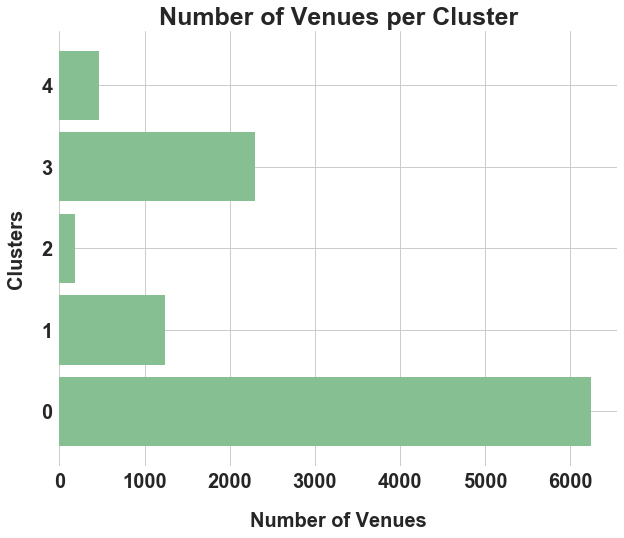

In [298]:
venues = nyvenuescount['Venues']
clusters = nyvenuescount['Cluster Labels']

fig, ax = plt.subplots(figsize=(10,8))
width = 0.85
ind = np.arange(len(venues))

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)


ax.barh(ind, venues, width, color='#86bf91')
ax.set_yticks(ind)
ax.set_yticklabels(clusters)
plt.xticks(fontsize=20,weight = 'bold')
plt.yticks(fontsize=20,weight = 'bold')
plt.title('Number of Venues per Cluster', fontsize = 25, weight = 'bold')
plt.xlabel('Number of Venues', fontsize = 20, labelpad=20,weight = 'bold')
plt.ylabel('Clusters', fontsize = 20, labelpad = 15,weight = 'bold')
plt.show()

In [71]:
nycnv = nn_cluster.join(nyvenuescount.set_index('Cluster Labels'), on=('Cluster Labels'))
nycnv.drop(['Neighborhood Ratio'], inplace=True, axis=1)
nycnv['Venue-Neighborhood Ratio'] = nycnv['Venues'] / nycnv['Neighborhood']
nycnv['Venue-Neighborhood Ratio'] = nycnv['Venue-Neighborhood Ratio'].round(decimals=0)

In [72]:
nycnv

,Cluster Labels,Neighborhood,Venues,Venue-Neighborhood Ratio
0,0,220,6242,28.0
1,1,30,1240,41.0
2,2,8,184,23.0
3,3,36,2292,64.0
4,4,12,463,39.0


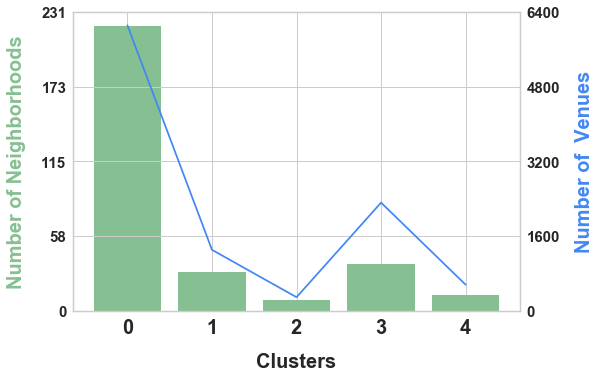

In [315]:
clusters = nycnv['Cluster Labels']
neighborhoods = nycnv['Neighborhood']
venues = nycnv['Venues']

fig, ax1 = plt.subplots()

ax2 = ax1.twinx()
ax1.bar(clusters, neighborhoods, color='#86bf91')
ax2.plot(clusters, venues, color='#4287f5')

ax1.set_yticks(np.linspace(*ax1.get_ybound(),5))
ax2.set_yticks(np.linspace(*ax2.get_ybound(),5))

ax1.set_xlabel('Clusters', fontsize=20 , labelpad=15, weight='bold')
ax1.set_ylabel('Number of Neighborhoods', color='#86bf91', fontsize=20 , labelpad=15, weight='bold')
ax2.set_ylabel('Number of  Venues', color='#4287f5', fontsize=20 , labelpad=15, weight='bold')
ax1.set_xticks(clusters)
ax1.set_xticklabels([0,1,2,3,4], fontsize=20, weight='bold') 
ax1.set_yticklabels([0,58,115,173,231],fontsize=15, weight='bold')
ax2.set_yticklabels([0,1600,3200,4800,6400],fontsize=15, weight='bold')

plt.show()

In [74]:
df1 = ny_onehot.groupby('Neighborhood').sum().reset_index()
df1 = df1.join(newyork_n.set_index('Neighborhood'), on=('Neighborhood'))
df1.drop(columns=['Latitude', 'Longitude'],inplace=True)
df1 = df1.set_index('Borough')
df1.reset_index(inplace=True)
df1.loc['Total'] = df1.sum()
df1total = df1.loc[['Total']]
df1total.drop(columns=['Borough', 'Neighborhood'], inplace=True)
df1total = df1total.transpose()
df1total.reset_index(inplace=True)
df1total = df1total.rename(columns={'index':'Venue Category'})

In [75]:
df1total

,Venue Category,Total
0,Yoga Studio,79
1,Accessories Store,10
2,Adult Boutique,1
3,Afghan Restaurant,2
4,African Restaurant,7
5,Airport Terminal,1
6,American Restaurant,171
7,Antique Shop,6
8,Arcade,2
9,Arepa Restaurant,10


In [77]:
df1['Total'] = df1.sum(axis=1)
df1bn = df1[['Borough','Neighborhood']]
df1bn = df1bn.drop(['Total'])
df1bn['Total'] = df1['Total']
df1bn

,Borough,Neighborhood,Total
0,Bronx,Allerton,30
1,Staten Island,Annadale,11
2,Staten Island,Arden Heights,5
3,Staten Island,Arlington,6
4,Staten Island,Arrochar,21
5,Queens,Arverne,20
6,Queens,Astoria,100
7,Queens,Astoria Heights,13
8,Queens,Auburndale,20
9,Brooklyn,Bath Beach,46


In [80]:
df1bn[df1bn.duplicated('Neighborhood')]

,Borough,Neighborhood,Total
13,Staten Island,Bay Terrace,23
51,Staten Island,Chelsea,53
189,Queens,Murray Hill,73
268,Staten Island,Sunnyside,23


In [79]:
df1bn.loc[df1bn['Neighborhood'] == 'Bay Terrace', 'Total'] = 23
df1bn.loc[df1bn['Neighborhood'] == 'Chelsea', 'Total'] = 53
df1bn.loc[df1bn['Neighborhood'] == 'Murray Hill', 'Total'] = 73
df1bn.loc[df1bn['Neighborhood'] == 'Sunnyside', 'Total'] = 23

In [81]:
df1top = df1total.sort_values('Total',ascending=False).reset_index(drop=True).head()
df1top

,Venue Category,Total
0,Pizza Place,452
1,Coffee Shop,328
2,Italian Restaurant,323
3,Deli / Bodega,273
4,Bar,235


In [82]:
df1bottom = df1total.sort_values('Total').reset_index(drop=True).head()
df1bottom

,Venue Category,Total
0,College Bookstore,1
1,Locksmith,1
2,Caucasian Restaurant,1
3,Leather Goods Store,1
4,College Basketball Court,1


In [83]:
df1

,Borough,Neighborhood,Yoga Studio,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,Auto Garage,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bath House,Beach,Beach Bar,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burmese Restaurant,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Campground,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Check Cashing Service,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Church,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Basketball Court,College Bookstore,College Cafeteria,College Stadium,College Theater,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dosa Place,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Exhibit,Eye Doctor,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Go Kart Track,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,Herbs & Spices Store,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Hotpot Restaurant,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Leather Goods Store,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Locksmith,Lounge,Malay Restaurant,Market,Martial Arts School,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Nightlife Spot,Non-Profit,Noodle House,North Indian Restaurant,Office,Opera House,Opt

In [84]:
df1.to_excel('NY Neighborhoods and Venues.xlsx')

In [85]:
df5 = df1

In [86]:
df5 = df5.loc[:,['Borough', 'Total']]
df5.drop(['Total'], inplace=True)
df5.reset_index(inplace=True, drop=True)
df5

,Borough,Total
0,Bronx,30
1,Staten Island,11
2,Staten Island,5
3,Staten Island,6
4,Staten Island,21
5,Queens,20
6,Queens,100
7,Queens,13
8,Queens,20
9,Brooklyn,46


In [87]:
df5 = df5.groupby('Borough').sum().reset_index()

In [88]:
df5

,Borough,Total
0,Bronx,1210
1,Brooklyn,2750
2,Manhattan,3255
3,Queens,2206
4,Staten Island,995


In [89]:
df5['Area (km2)'] = [110,180,59,280,152]
df5

,Borough,Total,Area (km2)
0,Bronx,1210,110
1,Brooklyn,2750,180
2,Manhattan,3255,59
3,Queens,2206,280
4,Staten Island,995,152


In [92]:
df5['Venues Density (km2)'] = df5['Total'] / df5['Area (km2)']
df5

,Borough,Total,Area (km2),Venues Density (km2)
0,Bronx,1210,110,11.000000
1,Brooklyn,2750,180,15.277778
2,Manhattan,3255,59,55.169492
3,Queens,2206,280,7.878571
4,Staten Island,995,152,6.546053
